#### *To run the model without retraining, please run steps **1, 2, 3, 4, 12** (Only run the **cells with installing packages commands**! **DO NOT RUN THE CELLS FOR TRAINING AND EVALUATING THE MODEL!**), 13 (Only run the cells under **Test the trained Object Detection model on images**)*

Please remember to upload the **customAAP** and **test_images** folder to the drive first if you are trying to **run the model without retraining!**

#**1) Import Libraries**

In [1]:
import os
import glob
import xml.etree.ElementTree as ET
import pandas as pd
import tensorflow as tf
print(tf.__version__)

2.8.2


Before moving on, firstly create a folder named **customAAP** in the drive. Then, create more folders named **data** and **training** (where checkpoints will be saved during training) in the **customAAP** folder. 

Furthemore, create a folder named **images** for the custom dataset images and create another folder named **annotations** for its corresponding xml files. Next, create their zip files and upload them to the **customAAP** folder in the drive. (Make sure all the image files have extension as **".jpg" only**. Other formats like ".png" , ".jpeg" or even ".JPG" will give errors since the generate_tfrecord and xml_to_csv scripts here have only ".jpg" in them)

Then, upload the **generate_tfrecord.py** file to the **customAAP** folder on the drive.


---

Originally, I wanted to use a Kaggle dataset containing e-waste images. However, some of the images used were irrelevant, some of the images consists of items that were broken and etc. They weren't the images that I was looking for. Therefore, I decided to use my own custom dataset for the model. Below is what I did:

In total, 152 images were downloaded via Google and annotated via labelImg. All images are in jpg format. All images are relevant to the problem as they are identified as e-waste that can be thrown to the ALBA bin. With the bin being able to detect the e-waste thrown, the bin will only accept accepted e-waste and reject unaccepted e-waste, making it easier for the workers since they do not have to manually separate those unaccepted e-waste from the bin. This means that even if people threw unaccepted e-waste into the bin due to not reading the instructions or etc, their waste would be rejected and given back to them. Out of the long list of e-waste that can thrown to the ALBA bin, I choose different images of printers, tvs, phones and laptops. My custom image dataset consists of e-waste images of different brands, colours and sizes so it can detect, for example, phones of different brands. As for the annotations, I manually annonated each one of the image as either phones, laptops, printers or tvs. In general, my dataset consists of 23 laptops images, 59 phones images, 54 printer images and 16 television images. My custom dataset will be used for training, validation and testing.

This step of Data Collection and Data Preparation is important as this allows for efficient analysis, limit errors and inaccuracies that can occur during processing/training. Some images I originally downloaded were corrupted and cannot be annotated, which would cause an issue if I left it as it is. With Data Preparation step, I was able to clean my data and choose data that is of quality which would bring me valuable insights and a high accuracy to detect the different types of e-waste.

#**2) Mount drive and link your folder**

In [2]:
from google.colab import drive
drive.mount('/content/gdrive')

# this creates a symbolic link so that now the path /content/gdrive/My\ Drive/ is equal to /mydrive
!ln -s /content/gdrive/My\ Drive/ /mydrive
!ls /mydrive

Mounted at /content/gdrive
'Colab Notebooks'   customAAP   test_images


# **3) Clone the tensorflow models git repository & Install TensorFlow Object Detection API**

In [3]:
# clone the tensorflow models on the colab cloud vm
!git clone --q https://github.com/tensorflow/models.git

#navigate to /models/research folder to compile protos
%cd models/research

# Compile protos.
!protoc object_detection/protos/*.proto --python_out=.

# Install TensorFlow Object Detection API.
!cp object_detection/packages/tf2/setup.py .
!python -m pip install .

/content/models/research
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Processing /content/models/research
  DEPRECATION: A future pip version will change local packages to be built in-place without first copying to a temporary directory. We recommend you use --use-feature=in-tree-build to test your packages with this new behavior before it becomes the default.
   pip 21.3 will remove support for this functionality. You can find discussion regarding this at https://github.com/pypa/pip/issues/7555.
     |████████████████████████████████| 10.3 MB 46.3 MB/s 
     |████████████████████████████████| 352 kB 73.7 MB/s 
     |████████████████████████████████| 2.1 MB 71.9 MB/s 
     |████████████████████████████████| 25.9 MB 1.5 MB/s 
     |████████████████████████████████| 67 kB 6.8 MB/s 
     |████████████████████████████████| 237 kB 77.3 MB/s 
     |████████████████████████████████| 92 kB 14.4 MB/s 
     |████████████████████████████████| 

# **4) Test the model builder**

In [4]:
# testing the model builder
!python object_detection/builders/model_builder_tf2_test.py

Running tests under Python 3.7.13: /usr/bin/python3
[ RUN      ] ModelBuilderTF2Test.test_create_center_net_deepmac
2022-06-11 09:21:54.678316: W tensorflow/core/common_runtime/gpu/gpu_bfc_allocator.cc:42] Overriding orig_value setting because the TF_FORCE_GPU_ALLOW_GROWTH environment variable is set. Original config value was 0.
W0611 09:21:54.907244 140591490340736 model_builder.py:1102] Building experimental DeepMAC meta-arch. Some features may be omitted.
INFO:tensorflow:time(__main__.ModelBuilderTF2Test.test_create_center_net_deepmac): 1.44s
I0611 09:21:55.274311 140591490340736 test_util.py:2459] time(__main__.ModelBuilderTF2Test.test_create_center_net_deepmac): 1.44s
[       OK ] ModelBuilderTF2Test.test_create_center_net_deepmac
[ RUN      ] ModelBuilderTF2Test.test_create_center_net_model0 (customize_head_params=True)
INFO:tensorflow:time(__main__.ModelBuilderTF2Test.test_create_center_net_model0 (customize_head_params=True)): 0.48s
I0611 09:21:55.756841 140591490340736 test_u

# **5) Navigate to /mydrive/customAAP/data/ and Unzip the *images.zip* and *annotations.zip* files into the *data* folder**


In [ ]:
%cd /mydrive/customAAP/data/

# unzip the datasets and their contents so that they are now in /mydrive/customAAP/data/ folder
!unzip /mydrive/customAAP/images.zip -d .
!unzip /mydrive/customAAP/annotations.zip -d .

/content/gdrive/My Drive/customAAP/data
Archive:  /mydrive/customAAP/images.zip
  inflating: ./images/l1.jpg         
  inflating: ./images/l10.jpg        
  inflating: ./images/l12.jpg        
  inflating: ./images/l14.jpg        
  inflating: ./images/l15.jpg        
  inflating: ./images/l17.jpg        
  inflating: ./images/l19.jpg        
  inflating: ./images/l2.jpg         
  inflating: ./images/l20.jpg        
  inflating: ./images/l21.jpg        
  inflating: ./images/l22.jpg        
  inflating: ./images/l23.jpg        
  inflating: ./images/l25.jpg        
  inflating: ./images/l3.jpg         
  inflating: ./images/l30.jpg        
  inflating: ./images/l31.jpg        
  inflating: ./images/l32.jpg        
  inflating: ./images/l33.jpg        
  inflating: ./images/l35.jpg        
  inflating: ./images/l4.jpg         
  inflating: ./images/l5.jpg         
  inflating: ./images/l8.jpg         
  inflating: ./images/l9.jpg         
  inflating: ./images/p1.jpg         
  inflat

# **6) Create test_labels & train_labels**
Current working directory is /mydrive/customAAP/data/

Divide annotations into test_labels(20%) and train_labels(80%).

In [ ]:
#creating two dir for training and testing
!mkdir test_labels train_labels

# lists the files inside 'annotations' in a random order (not really random, by their hash value instead)
# Moves the first 30/152 labels (20% of the labels) to the testing dir: `test_labels`
!ls annotations/* | sort -R | head -30 | xargs -I{} mv {} test_labels/


# Moves the rest of the labels ( 122 labels ) to the training dir: `train_labels`
!ls annotations/* | xargs -I{} mv {} train_labels/

*customTF2 in the diagram below should be customAAP*

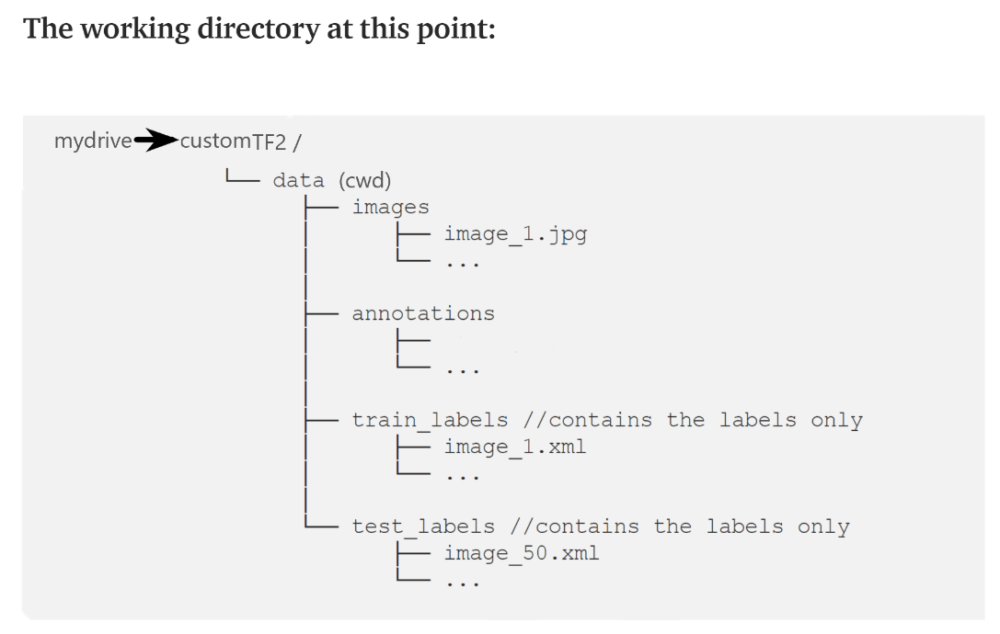

# **7) Create the CSV files and the "label_map.pbtxt" file**

Current working directory is /mydrive/customAAP/data/

Run xml_to_csv script below to create ***test_labels.csv*** and ***train_labels.csv***

This also creates the ***label_map.pbtxt*** file using the classes mentioned in the xml files. 

In [ ]:
#adjusted from: https://github.com/datitran/raccoon_dataset
def xml_to_csv(path):
  classes_names = []
  xml_list = []

  for xml_file in glob.glob(path + '/*.xml'):
    tree = ET.parse(xml_file)
    root = tree.getroot()
    for member in root.findall('object'):
      classes_names.append(member[0].text)
      value = (root.find('filename').text  ,   
               int(root.find('size')[0].text),
               int(root.find('size')[1].text),
               member[0].text,
               int(member[4][0].text),
               int(member[4][1].text),
               int(member[4][2].text),
               int(member[4][3].text))
      xml_list.append(value)
  column_name = ['filename', 'width', 'height', 'class', 'xmin', 'ymin', 'xmax', 'ymax']
  xml_df = pd.DataFrame(xml_list, columns=column_name) 
  classes_names = list(set(classes_names))
  classes_names.sort()
  return xml_df, classes_names

for label_path in ['train_labels', 'test_labels']:
  image_path = os.path.join(os.getcwd(), label_path)
  xml_df, classes = xml_to_csv(label_path)
  xml_df.to_csv(f'{label_path}.csv', index=None)
  print(f'Successfully converted {label_path} xml to csv.')

label_map_path = os.path.join("label_map.pbtxt")
pbtxt_content = ""

for i, class_name in enumerate(classes):
    pbtxt_content = (
        pbtxt_content
        + "item {{\n    id: {0}\n    name: '{1}'\n}}\n\n".format(i + 1, class_name)
    )
pbtxt_content = pbtxt_content.strip()
with open(label_map_path, "w") as f:
    f.write(pbtxt_content)
    print('Successfully created label_map.pbtxt ')

Successfully converted train_labels xml to csv.
Successfully converted test_labels xml to csv.
Successfully created label_map.pbtxt 


*customTF2 in the diagram below should be customAAP*

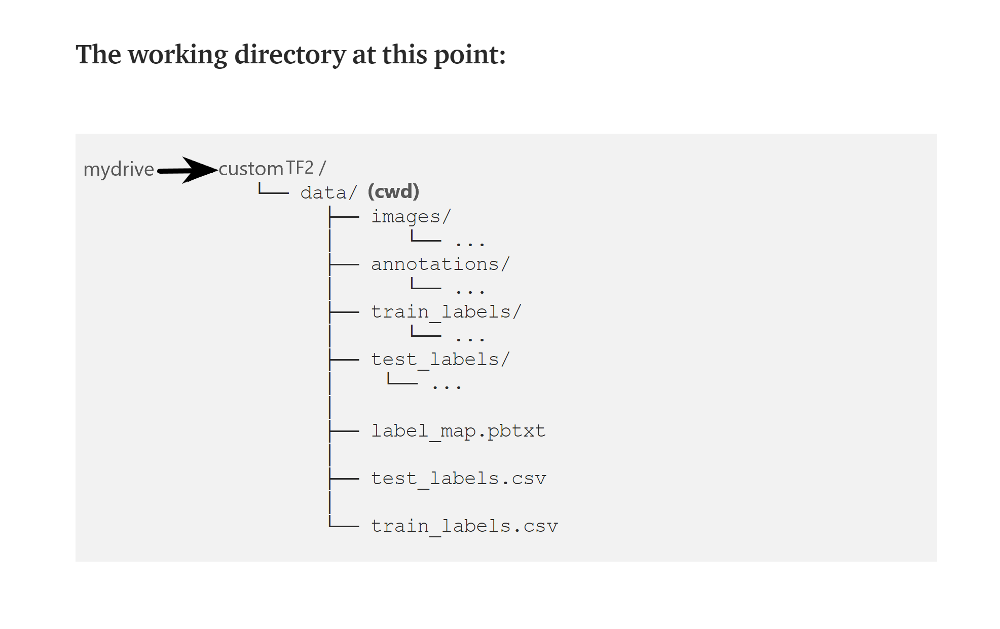

# **8) Create train.record & test.record files**

Current working directory is /mydrive/customAAP/data/

Run the *generate_tfrecord.py* script to create *train.record* and *test.record* files

In [ ]:
#Usage:  
#!python generate_tfrecord.py output.csv output_pb.txt /path/to/images output.tfrecords

#For train.record
!python /mydrive/customAAP/generate_tfrecord.py train_labels.csv  label_map.pbtxt images/ train.record

#For test.record
!python /mydrive/customAAP/generate_tfrecord.py test_labels.csv  label_map.pbtxt images/ test.record

groups: 100% 122/122 [00:00<00:00, 314.09it/s]
Successfully created the TFRecords: /content/gdrive/MyDrive/customAAP/data/train.record
groups: 100% 30/30 [00:00<00:00, 247.19it/s]
Successfully created the TFRecords: /content/gdrive/My Drive/customAAP/data/test.record


# **9) Download pre-trained model checkpoint** 

Current working directory is /mydrive/customAAP/data/

Download **ssd_mobilenet_v2_fpnlite_320x320_coco17_tpu-8.tar.gz** into the ***data*** folder & unzip it.

In [ ]:
#Download the pre-trained model ssd_mobilenet_v2_fpnlite_320x320_coco17_tpu-8.tar.gz into the data folder & unzip it.

!wget http://download.tensorflow.org/models/object_detection/tf2/20200711/ssd_mobilenet_v2_fpnlite_320x320_coco17_tpu-8.tar.gz
!tar -xzvf ssd_mobilenet_v2_fpnlite_320x320_coco17_tpu-8.tar.gz

--2022-06-09 08:18:44--  http://download.tensorflow.org/models/object_detection/tf2/20200711/ssd_mobilenet_v2_fpnlite_320x320_coco17_tpu-8.tar.gz
Resolving download.tensorflow.org (download.tensorflow.org)... 173.194.210.128, 2607:f8b0:400c:c0f::80
Connecting to download.tensorflow.org (download.tensorflow.org)|173.194.210.128|:80... connected.
HTTP request sent, awaiting response... 200 OK
Length: 20515344 (20M) [application/x-tar]
Saving to: ‘ssd_mobilenet_v2_fpnlite_320x320_coco17_tpu-8.tar.gz’

ssd_mobilenet_v2_fp 100%[===================>]  19.56M  63.4MB/s    in 0.3s    

2022-06-09 08:18:45 (63.4 MB/s) - ‘ssd_mobilenet_v2_fpnlite_320x320_coco17_tpu-8.tar.gz’ saved [20515344/20515344]

ssd_mobilenet_v2_fpnlite_320x320_coco17_tpu-8/
ssd_mobilenet_v2_fpnlite_320x320_coco17_tpu-8/checkpoint/
ssd_mobilenet_v2_fpnlite_320x320_coco17_tpu-8/checkpoint/ckpt-0.data-00000-of-00001
ssd_mobilenet_v2_fpnlite_320x320_coco17_tpu-8/checkpoint/checkpoint
ssd_mobilenet_v2_fpnlite_320x320_coco17_tp

# **10) Get the model pipeline config file, make changes to it and put it inside the *data* folder**

Current working directory is /mydrive/customAAP/data/

Edit the config file from ***/content/models/research/object_detection/configs/tf2*** in colab and copy the edited config file to the ***/mydrive/customAAP/data*** folder.

I can also find the pipeline config file inside the model checkpoint folder we just downloaded in the previous step.

**I need to make the following changes:**
*   change ***num_classes*** to number of my classes (which is **4 classes** - ***printers, phones, tvs, laptops***)
*   change ***test.record*** path, ***train.record*** path & ***labelmap*** path to the paths where I have created these files (paths should be relative to my current working directory while training).<br> **The path(s):**

  *   **test.record** - /content/gdrive/MyDrive/customAAP/data/test.record
  *   **train.record** - /content/gdrive/MyDrive/customAAP/data/train.record
  *   **labelmap.pbtxt** - /content/gdrive/MyDrive/customAAP/data/label_map.pbtxt
* change ***fine_tune_checkpoint*** to the path of the directory of the downloaded checkpoint (which is the path)
* change ***fine_tune_checkpoint_type*** to value **detection**.
* change ***batch_size*** to any multiple of 8 depending upon the capability of my GPU.
(eg:- 24,128,...,512). **Mine is set to 32**. Considering that we are using Google Colab free, I cannot set a batch size that is too high. Else, I will get a "resource exhausted" error, which is caused by running out of memory.
* change ***num_steps*** to number of steps I want the detector to train. **Mine is set to 20k steps**.





In [ ]:
#copy the edited config file from the configs/tf2 directory to the data/ folder in your drive

!cp /content/models/research/object_detection/configs/tf2/ssd_mobilenet_v2_fpnlite_320x320_coco17_tpu-8.config /mydrive/customAAP/data

# **11) Load Tensorboard**
To visualise the model easily

In [7]:
#load tensorboard

%load_ext tensorboard         
# %tensorboard --logdir '/content/gdrive/MyDrive/customAAP/training'
%tensorboard --logdir '/content/gdrive/MyDrive/customAAP/training/train'

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


<IPython.core.display.Javascript object>

In [9]:
# If the tensorboard extension is already loaded, reload it using:
%reload_ext tensorboard
# %tensorboard --logdir '/content/gdrive/MyDrive/customAAP/training'
%tensorboard --logdir '/content/gdrive/MyDrive/customAAP/training/train'

Reusing TensorBoard on port 6007 (pid 619), started 0:01:59 ago. (Use '!kill 619' to kill it.)

<IPython.core.display.Javascript object>

# **12) Train the model** 

## Navigate to the ***object_detection*** folder in google colab

In [10]:
%cd /content/models/research/object_detection

/content/models/research/object_detection


## ***Troubleshooting*** so that there won't be any erorrs while training the model.

In [11]:
!pip list|grep opencv

opencv-contrib-python         4.1.2.30
opencv-python                 4.1.2.30
opencv-python-headless        4.6.0.66


In [12]:
!pip uninstall opencv-python-headless --y

!pip install opencv-python-headless==4.1.2.30

Found existing installation: opencv-python-headless 4.6.0.66
Uninstalling opencv-python-headless-4.6.0.66:
  Successfully uninstalled opencv-python-headless-4.6.0.66
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 21.8 MB 1.0 MB/s 


In [13]:
!apt install --allow-change-held-packages libcudnn8=8.1.0.77-1+cuda11.2

Reading package lists... Done
Building dependency tree       
Reading state information... Done
The following package was automatically installed and is no longer required:
  libnvidia-common-460
Use 'apt autoremove' to remove it.
The following packages will be REMOVED:
  libcudnn8-dev
The following held packages will be changed:
  libcudnn8
The following packages will be upgraded:
  libcudnn8
1 upgraded, 0 newly installed, 1 to remove and 43 not upgraded.
Need to get 430 MB of archives.
After this operation, 3,139 MB disk space will be freed.
Get:1 https://developer.download.nvidia.com/compute/cuda/repos/ubuntu1804/x86_64  libcudnn8 8.1.0.77-1+cuda11.2 [430 MB]
Fetched 430 MB in 11s (37.6 MB/s)
(Reading database ... 155632 files and directories currently installed.)
Removing libcudnn8-dev (8.0.5.39-1+cuda11.1) ...
(Reading database ... 155610 files and directories currently installed.)
Preparing to unpack .../libcudnn8_8.1.0.77-1+cuda11.2_amd64.deb ...
Unpacking libcudnn8 (8.1.0.77-1+

## 12 (a) Training using model_main_tf2.py

Here **{PIPELINE_CONFIG_PATH}** points to the pipeline config and **{MODEL_DIR}** points to the directory in which training checkpoints and events will be written.

For best results, stop the training when the loss is less than 0.1 if possible, else train the model until the loss does not show any significant change for a while. The ideal loss should be below 0.05 (Try to get the loss as low as possible without overfitting the model. Don’t go too high on training steps to try and lower the loss if the model has already converged viz. if it does not reduce loss significantly any further and takes a while to go down. )


---


**I trained my model for 20k steps for more than 5 hours, getting a loss of 0.0799 for last 1k steps.**

Considering that the GPU capability for free on Colab and my dataset size is not that big, my batch size is set to 32. With every 100-step, I am able to see the progress of the model, whether the loss has decreased or maintained or etc. Aiming for a loss of less than 0.1, I trained for more than 20000 steps, so as to minimize the error as much as possible, allowing the model to detect e-waste with better accuracy.

In [ ]:
# Run the command below from the content/models/research/object_detection directory
"""
PIPELINE_CONFIG_PATH=path/to/pipeline.config
MODEL_DIR=path to training checkpoints directory
NUM_TRAIN_STEPS=50000
SAMPLE_1_OF_N_EVAL_EXAMPLES=1

python model_main_tf2.py -- \
  --model_dir=$MODEL_DIR --num_train_steps=$NUM_TRAIN_STEPS \
  --sample_1_of_n_eval_examples=$SAMPLE_1_OF_N_EVAL_EXAMPLES \
  --pipeline_config_path=$PIPELINE_CONFIG_PATH \
  --alsologtostderr
"""

!python model_main_tf2.py --pipeline_config_path=/mydrive/customAAP/data/ssd_mobilenet_v2_fpnlite_320x320_coco17_tpu-8.config --model_dir=/mydrive/customAAP/training --alsologtostderr

2022-06-09 10:25:13.607522: W tensorflow/core/common_runtime/gpu/gpu_bfc_allocator.cc:42] Overriding orig_value setting because the TF_FORCE_GPU_ALLOW_GROWTH environment variable is set. Original config value was 0.
INFO:tensorflow:Using MirroredStrategy with devices ('/job:localhost/replica:0/task:0/device:GPU:0',)
I0609 10:25:13.613031 139864978487168 mirrored_strategy.py:374] Using MirroredStrategy with devices ('/job:localhost/replica:0/task:0/device:GPU:0',)
INFO:tensorflow:Maybe overwriting train_steps: None
I0609 10:25:14.130819 139864978487168 config_util.py:552] Maybe overwriting train_steps: None
INFO:tensorflow:Maybe overwriting use_bfloat16: False
I0609 10:25:14.131039 139864978487168 config_util.py:552] Maybe overwriting use_bfloat16: False
Instructions for updating:
rename to distribute_datasets_from_function
W0609 10:25:14.273116 139864978487168 deprecation.py:356] From /usr/local/lib/python3.7/dist-packages/object_detection/model_lib_v2.py:564: StrategyBase.experimental

## 12 (b) Evaluation using model_main_tf2.py (Optional)

This can be run this in parallel by opening another colab notebook and running this command simultaneously along with the training command above (don't forget to mount drive, clone the TF git repo and install the TF2 object detection API there as well). This will give you validation loss, mAP, etc so you have a better idea of how your model is performing.

Here **{CHECKPOINT_DIR}** points to the directory with checkpoints produced by the training job. Evaluation events are written to **{MODEL_DIR/eval}**. 

In [ ]:
# Run the command below from the content/models/research/object_detection directory (optional step)
"""
PIPELINE_CONFIG_PATH=path/to/pipeline.config
MODEL_DIR=path to training checkpoints directory
CHECKPOINT_DIR=${MODEL_DIR}
NUM_TRAIN_STEPS=50000
SAMPLE_1_OF_N_EVAL_EXAMPLES=1

python model_main_tf2.py -- \
  --model_dir=$MODEL_DIR --num_train_steps=$NUM_TRAIN_STEPS \
  --checkpoint_dir=${CHECKPOINT_DIR} \
  --sample_1_of_n_eval_examples=$SAMPLE_1_OF_N_EVAL_EXAMPLES \
  --pipeline_config_path=$PIPELINE_CONFIG_PATH \
  --alsologtostderr
"""

!python model_main_tf2.py --pipeline_config_path=/mydrive/customAAP/data/ssd_mobilenet_v2_fpnlite_320x320_coco17_tpu-8.config --model_dir=/mydrive/customAAP/training/ --checkpoint_dir=/mydrive/customAAP/training/ --alsologtostderr

W0609 14:09:09.499327 140152330684288 model_lib_v2.py:1090] Forced number of epochs for all eval validations to be 1.
INFO:tensorflow:Maybe overwriting sample_1_of_n_eval_examples: None
I0609 14:09:09.499643 140152330684288 config_util.py:552] Maybe overwriting sample_1_of_n_eval_examples: None
INFO:tensorflow:Maybe overwriting use_bfloat16: False
I0609 14:09:09.499745 140152330684288 config_util.py:552] Maybe overwriting use_bfloat16: False
INFO:tensorflow:Maybe overwriting eval_num_epochs: 1
I0609 14:09:09.499825 140152330684288 config_util.py:552] Maybe overwriting eval_num_epochs: 1
W0609 14:09:09.499932 140152330684288 model_lib_v2.py:1110] Expected number of evaluation epochs is 1, but instead encountered `eval_on_train_input_config.num_epochs` = 0. Overwriting `num_epochs` to 1.
2022-06-09 14:09:10.339904: W tensorflow/core/common_runtime/gpu/gpu_bfc_allocator.cc:42] Overriding orig_value setting because the TF_FORCE_GPU_ALLOW_GROWTH environment variable is set. Original config 

##**Retraining the model (in case I get disconnected)**


If I get disconnected or lose my session on Google Colab, I can start my training where I left off as the checkpoint is saved on my drive inside the ***training*** folder. To restart the training simply run **steps 1, 2, 3, 4, 10, and 11**

Note that since we have all the files required for training like the record files,our edited pipeline config file,the label_map file and the model checkpoint folder, therefore we do not need to create these again. 

**The model_main_tf2.py script saves the checkpoint every 1000 steps.** The training automatically restarts from the last saved checkpoint itself.

However, if I see that it doesn't restart training from the last checkpoint, I can make 1 change in the pipeline config file. Change **fine_tune_checkpoint** to where my latest trained checkpoints have been written and have it point to the latest checkpoint as shown below:


``` 
fine_tune_checkpoint: "/mydrive/customAAP/training/ckpt-X" (where ckpt-X is the latest checkpoint)

```

# **13) Test the trained model**

## Export inference graph

Current working directory is /content/models/research/object_detection

In [ ]:
##Export inference graph
!python exporter_main_v2.py --trained_checkpoint_dir=/mydrive/customAAP/training --pipeline_config_path=/content/gdrive/MyDrive/customAAP/data/ssd_mobilenet_v2_fpnlite_320x320_coco17_tpu-8.config --output_directory /mydrive/customAAP/data/inference_graph

2022-06-09 14:10:59.488929: W tensorflow/core/common_runtime/gpu/gpu_bfc_allocator.cc:42] Overriding orig_value setting because the TF_FORCE_GPU_ALLOW_GROWTH environment variable is set. Original config value was 0.
Instructions for updating:
back_prop=False is deprecated. Consider using tf.stop_gradient instead.
Instead of:
results = tf.map_fn(fn, elems, back_prop=False)
Use:
results = tf.nest.map_structure(tf.stop_gradient, tf.map_fn(fn, elems))
W0609 14:10:59.641049 140526712924032 deprecation.py:628] From /usr/local/lib/python3.7/dist-packages/tensorflow/python/autograph/impl/api.py:458: calling map_fn_v2 (from tensorflow.python.ops.map_fn) with back_prop=False is deprecated and will be removed in a future version.
Instructions for updating:
back_prop=False is deprecated. Consider using tf.stop_gradient instead.
Instead of:
results = tf.map_fn(fn, elems, back_prop=False)
Use:
results = tf.nest.map_structure(tf.stop_gradient, tf.map_fn(fn, elems))
W0609 14:11:18.560154 1405267129240

## Test the trained Object Detection model on images

Current working directory is /content/models/research/object_detection <br>
**Threshold is set to 0.8.**
Model is being tested on images from test_images folder (**18 images in total**). This is to see whether the model is able detect images of e-waste outside of the custom dataset. Some pictures are centered individually, or with other e-waste items (such as laptops with printers and etc.)

In [14]:
%cd /content/models/research/object_detection

/content/models/research/object_detection


In [15]:
# Different font-type for labels text.(This step is optional)
!wget https://freefontsdownload.net/download/160187/arial.zip
!unzip arial.zip -d .

%cd utils/
!sed -i "s/font = ImageFont.truetype('arial.ttf', 24)/font = ImageFont.truetype('arial.ttf', 50)/" visualization_utils.py
%cd ..

--2022-06-11 09:29:15--  https://freefontsdownload.net/download/160187/arial.zip
Resolving freefontsdownload.net (freefontsdownload.net)... 104.21.75.182, 172.67.180.27, 2606:4700:3036::6815:4bb6, ...
Connecting to freefontsdownload.net (freefontsdownload.net)|104.21.75.182|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 172804 (169K) [application/force-download]
Saving to: ‘arial.zip’

arial.zip           100%[===================>] 168.75K  --.-KB/s    in 0.09s   

2022-06-11 09:29:15 (1.93 MB/s) - ‘arial.zip’ saved [172804/172804]

Archive:  arial.zip
@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@
@#################################@
@#        Downloaded from        #@
@#                               #@
@#   www.FreeFontsDownload.net   #@
@#                               #@
@# ---------- More site -------- #@
@#      https://funnytv.net      #@
@#                               #@
@#                               #@
@#################################@
@@@@@@@@@@@@@@@@@@

In [16]:
# some more troubleshooting to avoid errors when running the next code
!pip install opencv-contrib-python

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


Loading model...Done!
(1, 710, 770, 3)


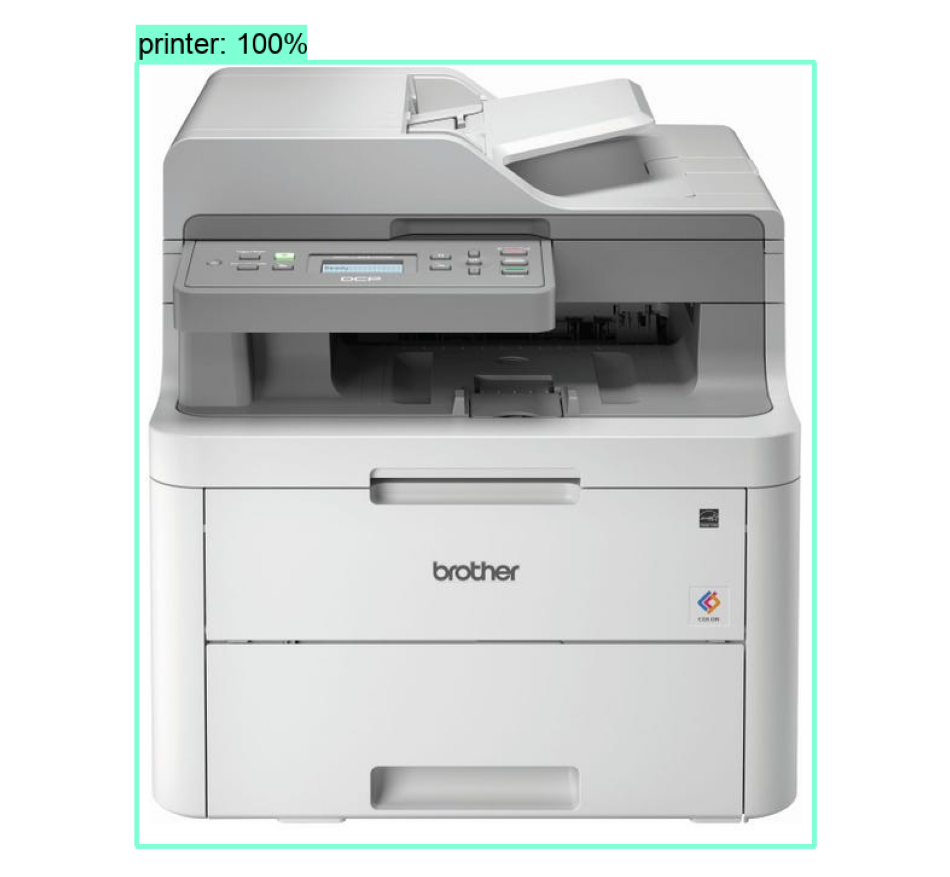

(1, 1000, 1000, 3)


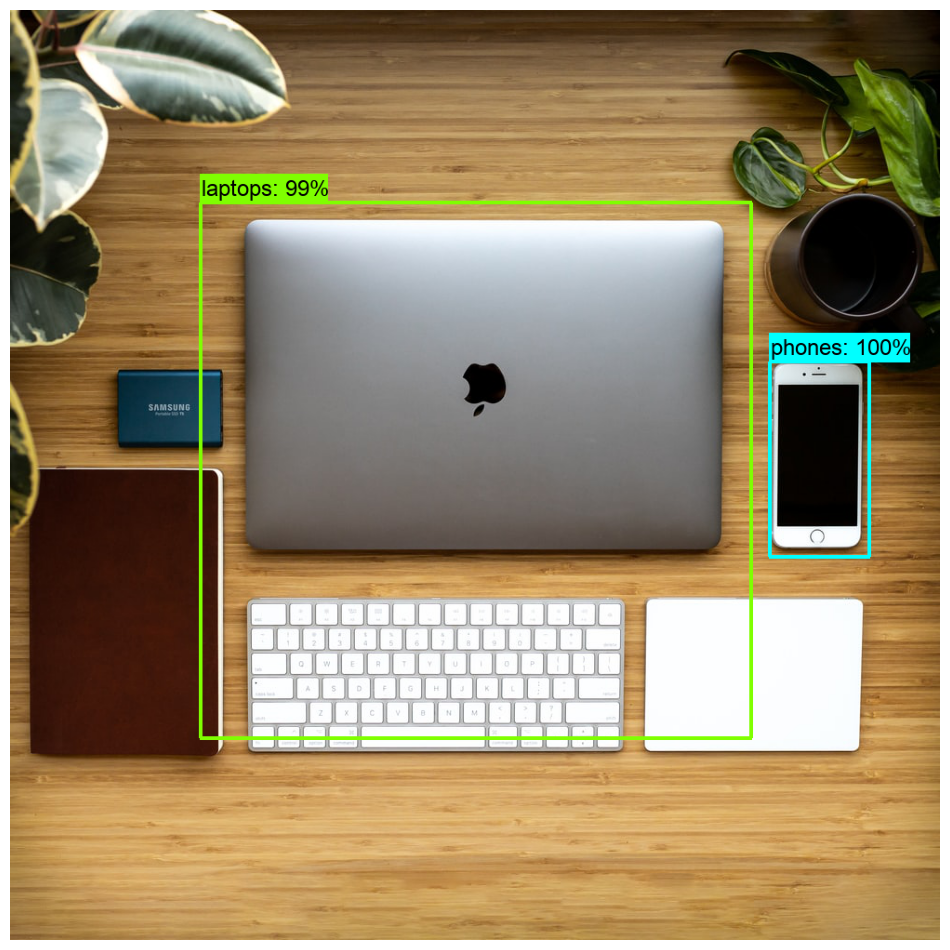

(1, 768, 768, 3)


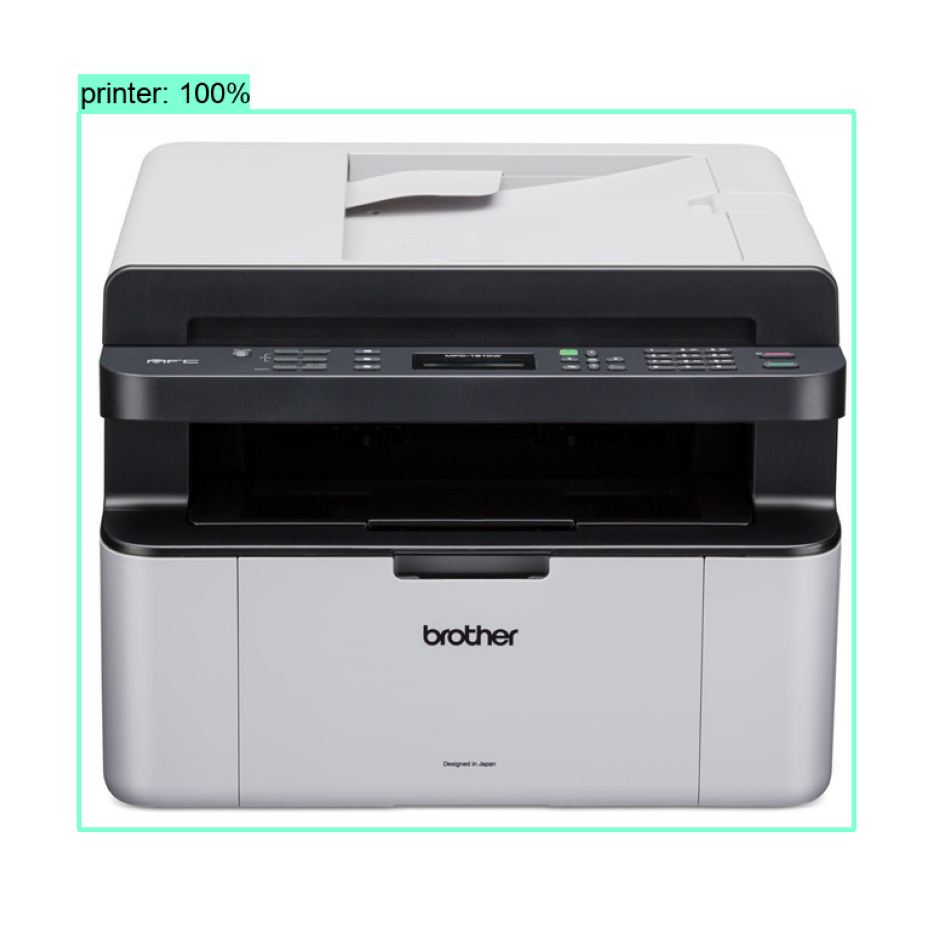

(1, 1050, 1200, 3)


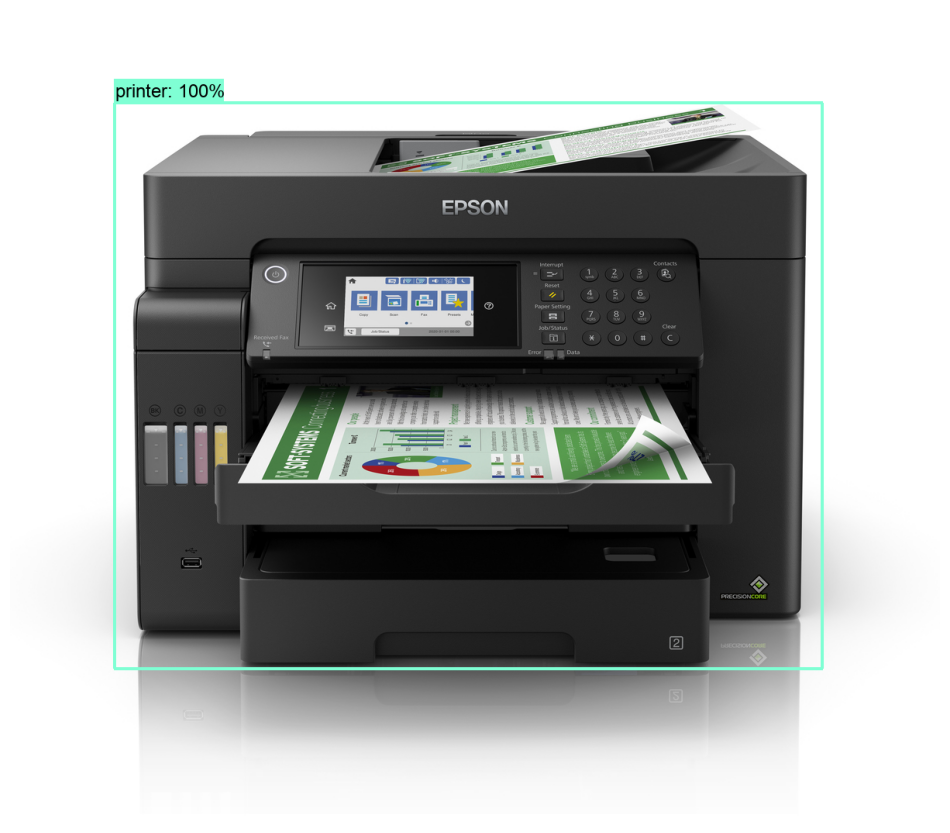

(1, 1125, 2000, 3)


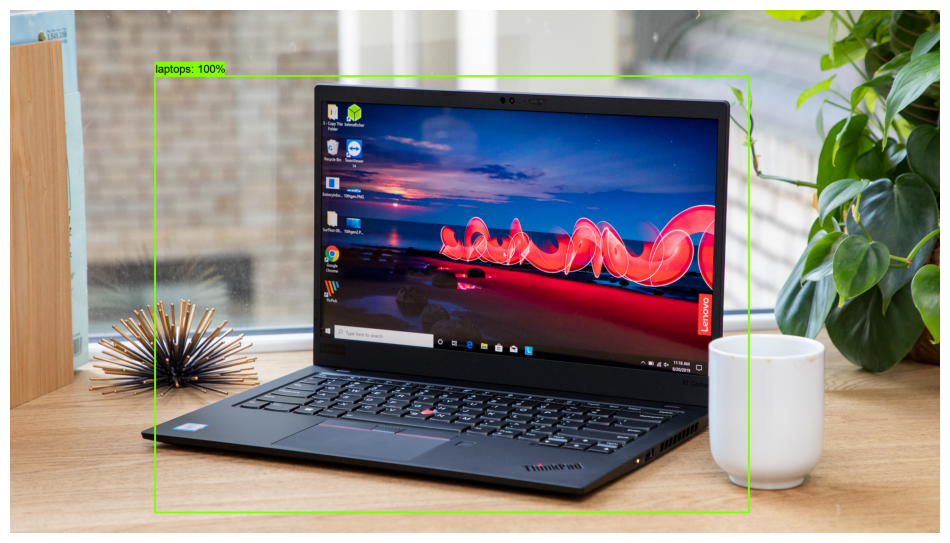

(1, 640, 640, 3)


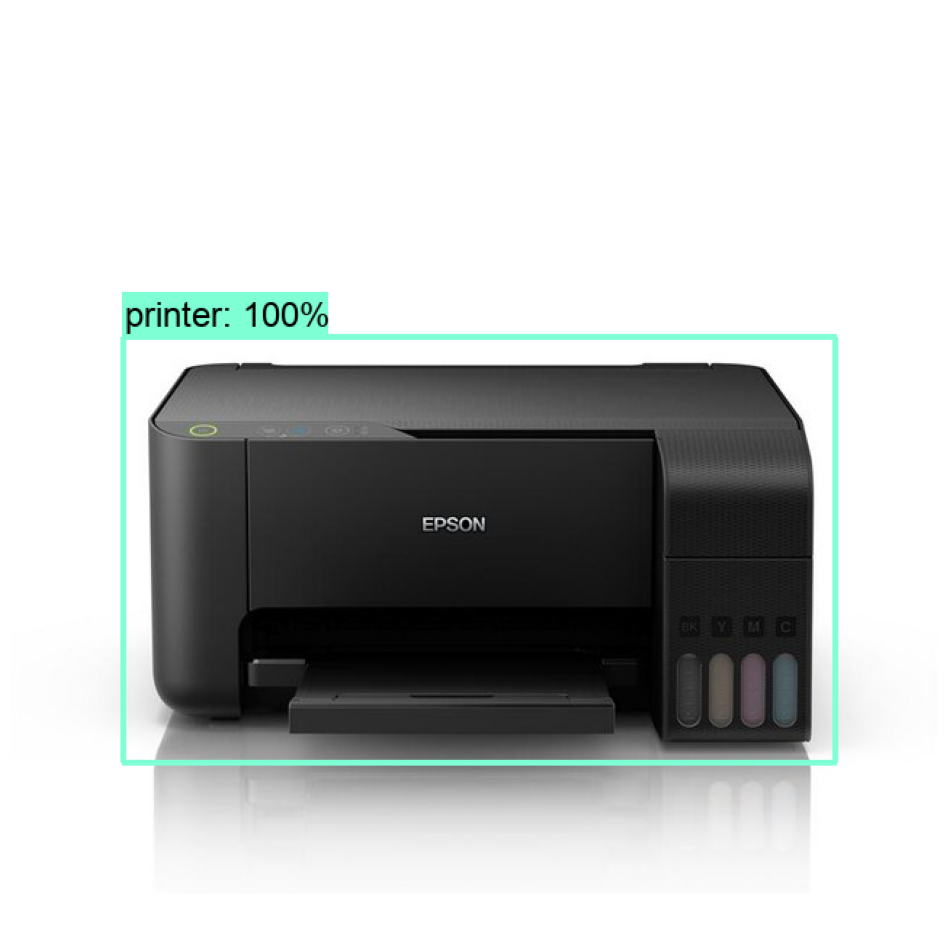

(1, 470, 838, 3)


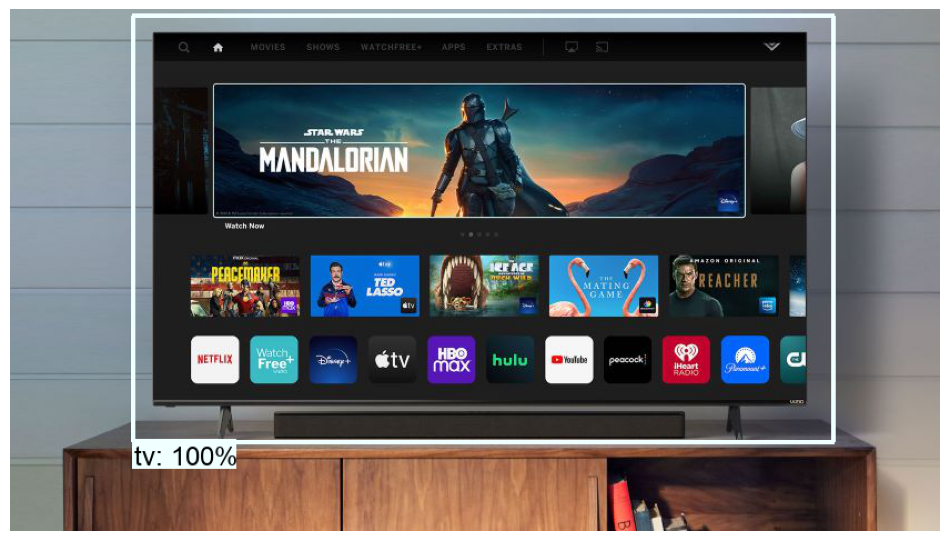

(1, 433, 650, 3)


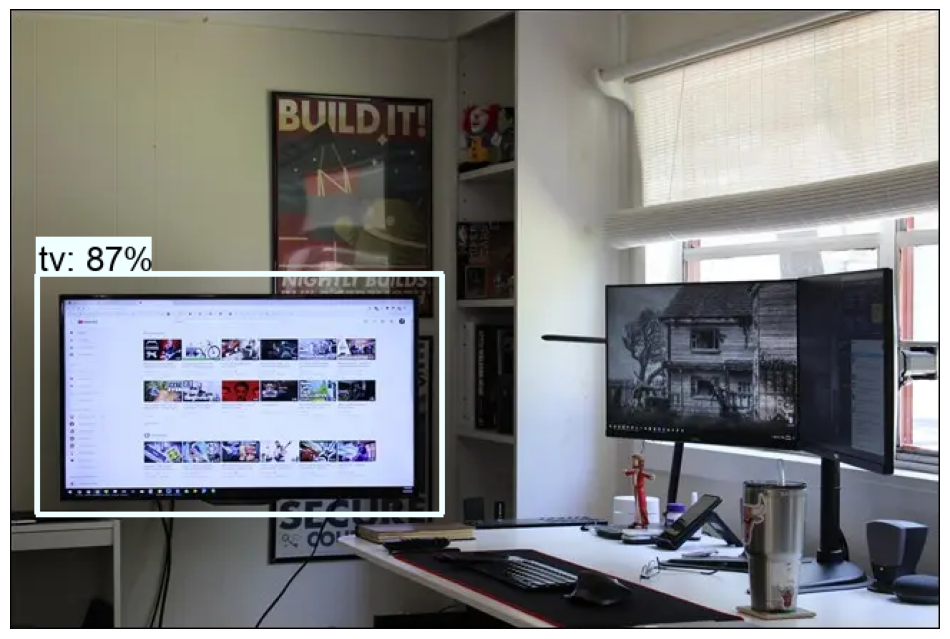

(1, 805, 1000, 3)


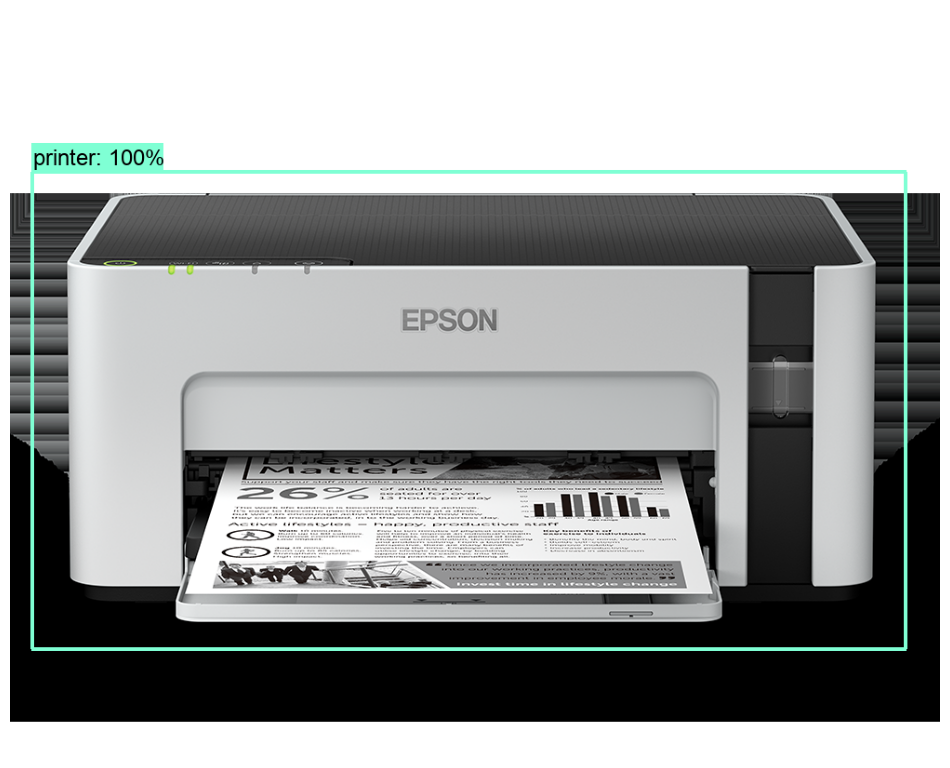

(1, 1440, 1440, 3)


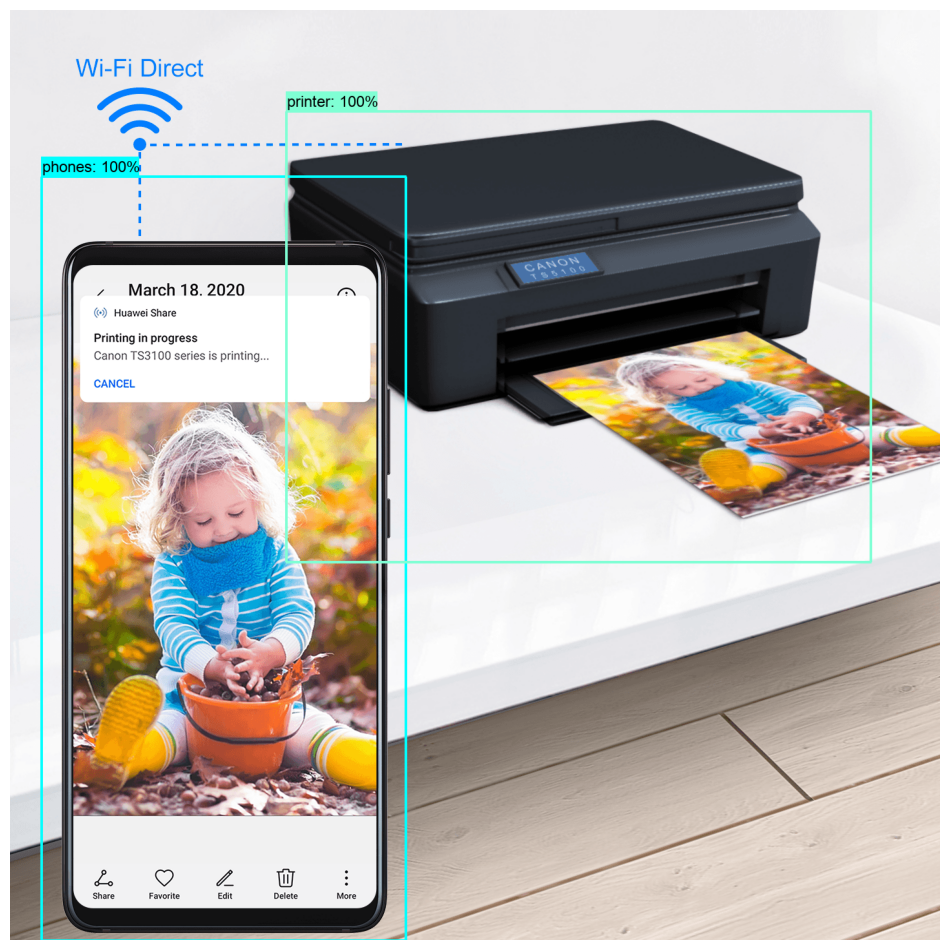

(1, 528, 940, 3)


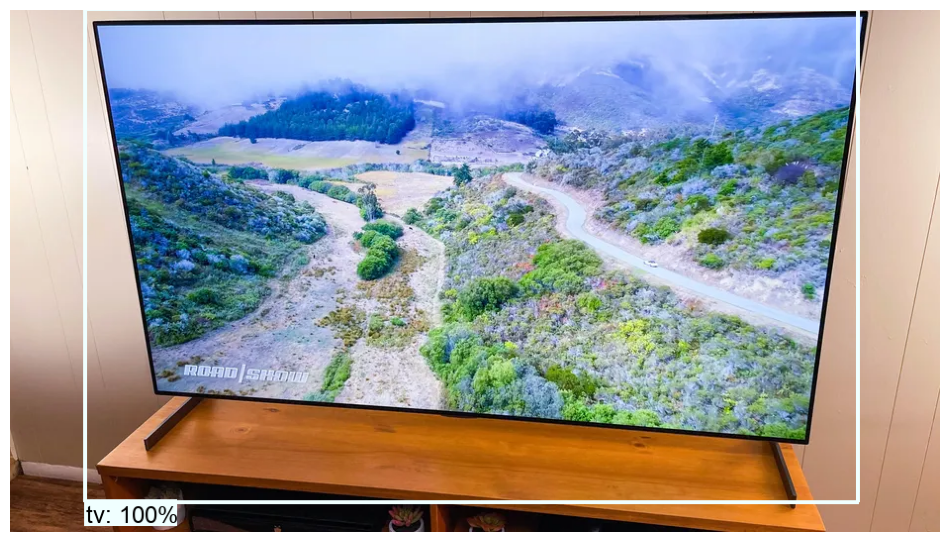

(1, 450, 720, 3)


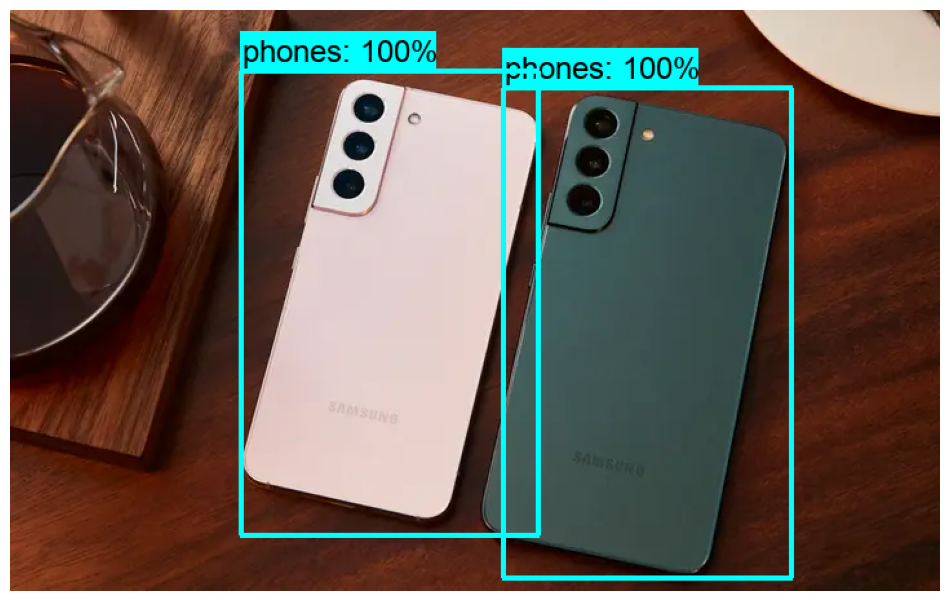

(1, 1500, 2000, 3)


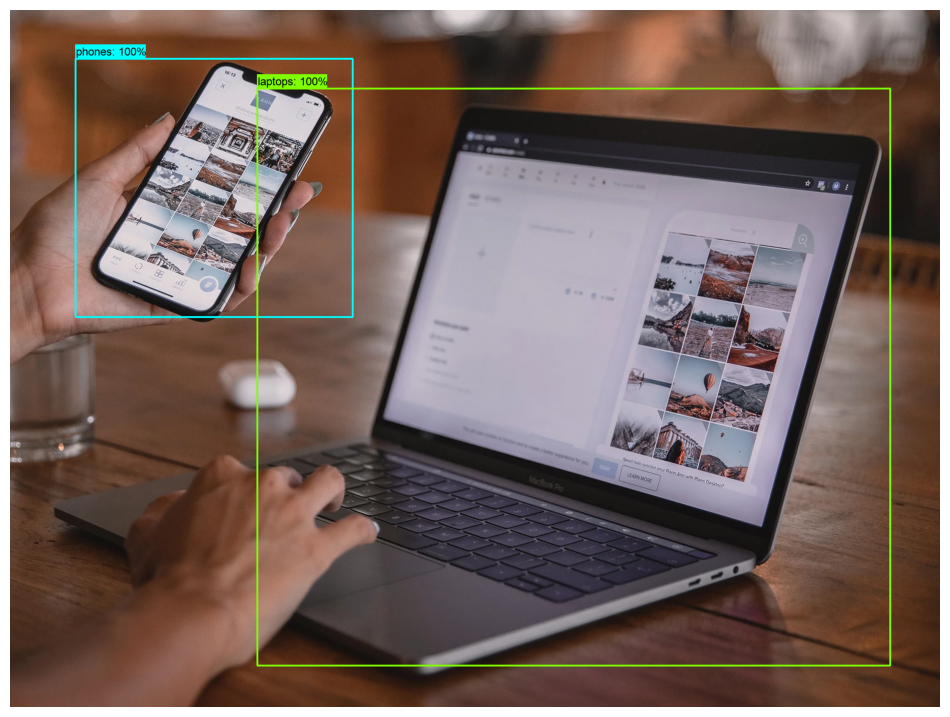

(1, 1080, 1920, 3)


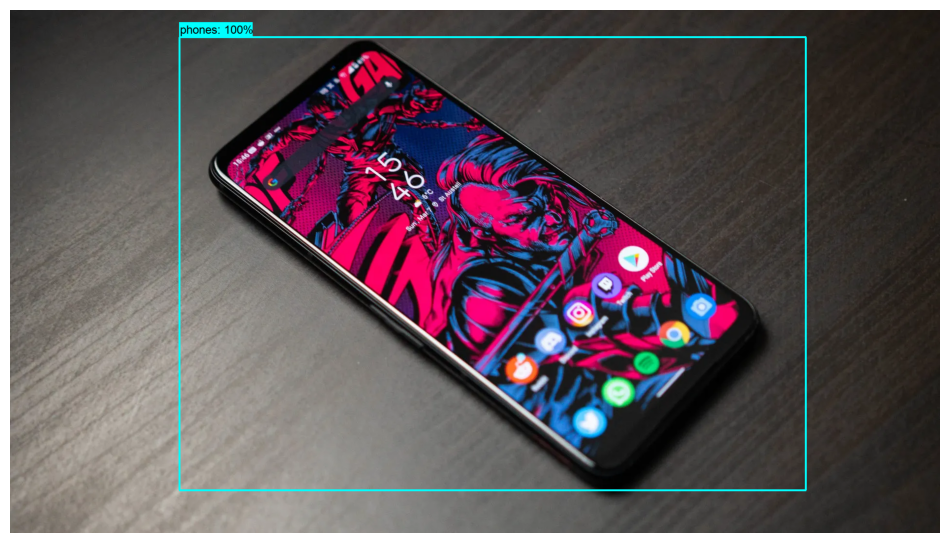

(1, 675, 1200, 3)


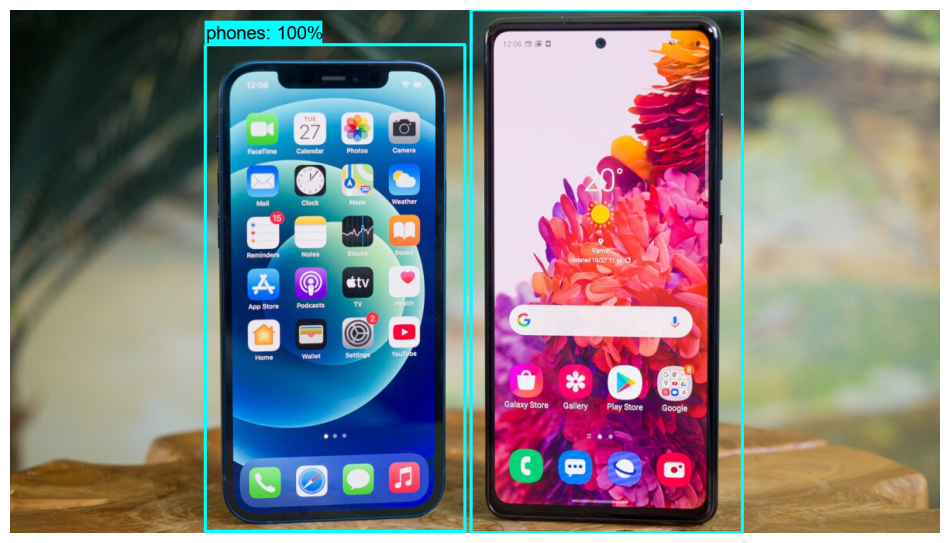

(1, 1805, 3208, 3)


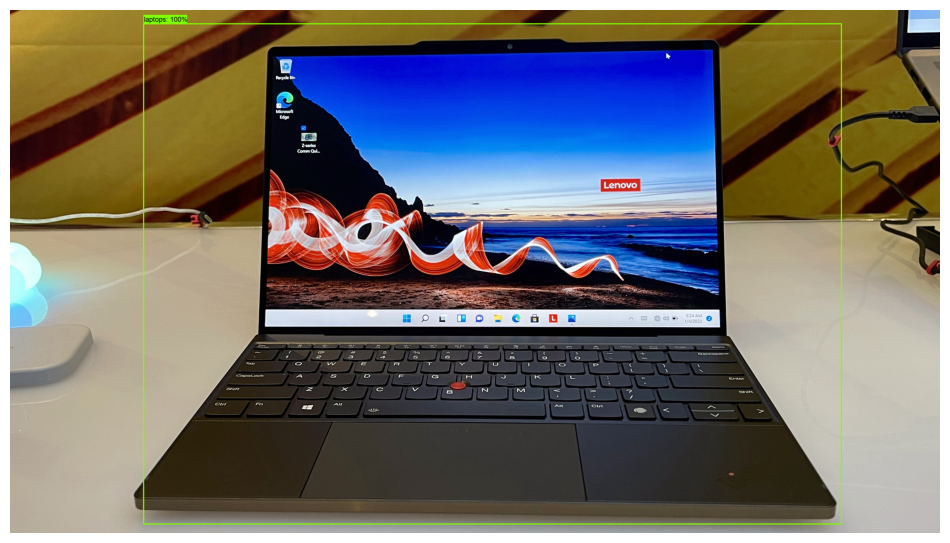

(1, 400, 570, 3)


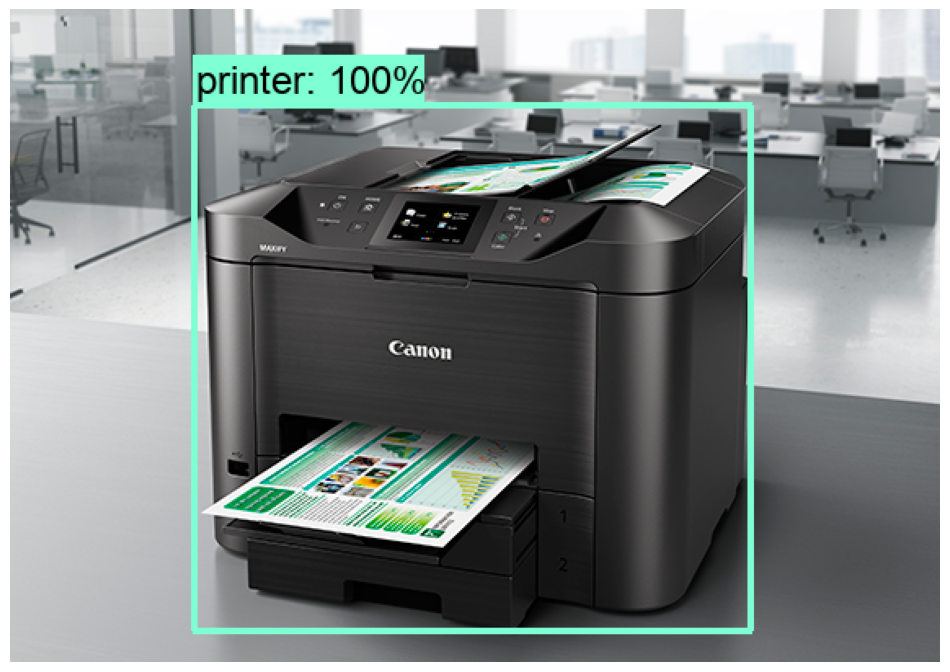

(1, 727, 1023, 3)


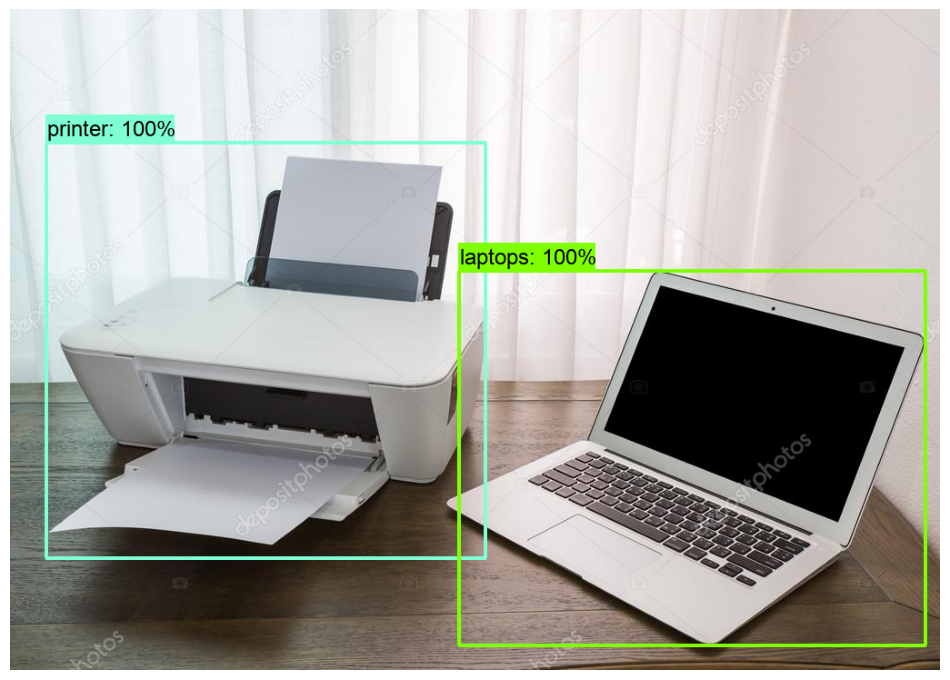

In [17]:
#Loading the saved_model
import tensorflow as tf
import time
import numpy as np
import warnings
warnings.filterwarnings('ignore')
from PIL import Image
from google.colab.patches import cv2_imshow
from object_detection.utils import label_map_util
from object_detection.utils import visualization_utils as viz_utils


IMAGE_SIZE = (12, 20) # Output display size as I want
import matplotlib.pyplot as plt
PATH_TO_SAVED_MODEL="/mydrive/customAAP/data/inference_graph/saved_model"
print('Loading model...', end='')

# Load saved model and build the detection function
detect_fn=tf.saved_model.load(PATH_TO_SAVED_MODEL)
print('Done!')

#Loading the label_map
category_index=label_map_util.create_category_index_from_labelmap("/mydrive/customAAP/data/label_map.pbtxt",use_display_name=True)
#category_index=label_map_util.create_category_index_from_labelmap([path_to_label_map],use_display_name=True)

def load_image_into_numpy_array(path):

    return np.array(Image.open(path).convert('RGB'))
    # converted to rgb (3 channels) in cases for images with 4 channels

# to detect all the test_images at the same instead of changing the image_path everytime
folder_dir = "/mydrive/test_images/"

for images in os.listdir(folder_dir):
    # try:
    if images.endswith(".jpg"):

      # image_path = "/mydrive/printers_test_images/test9.jpg"
      # image_path = "/mydrive/test_images/test1.jpg"
      #print('Running inference for {}... '.format(image_path), end='')
      image_path = folder_dir + images
      image_np = load_image_into_numpy_array(image_path)

      # The input needs to be a tensor, convert it using `tf.convert_to_tensor`.
      input_tensor = tf.convert_to_tensor(image_np)
      # The model expects a batch of images, so add an axis with `tf.newaxis`.
      input_tensor = input_tensor[tf.newaxis, ...]
      print(input_tensor.shape)

      detections = detect_fn(input_tensor)

      # All outputs are batches tensors.
      # Convert to numpy arrays, and take index [0] to remove the batch dimension.
      # We're only interested in the first num_detections.
      num_detections = int(detections.pop('num_detections'))
      detections = {key: value[0, :num_detections].numpy()
                    for key, value in detections.items()}
      detections['num_detections'] = num_detections

      # detection_classes should be ints.
      detections['detection_classes'] = detections['detection_classes'].astype(np.int64)

      image_np_with_detections = image_np.copy()

      viz_utils.visualize_boxes_and_labels_on_image_array(
            image_np_with_detections,
            detections['detection_boxes'],
            detections['detection_classes'],
            detections['detection_scores'],
            category_index,
            use_normalized_coordinates=True,
            max_boxes_to_draw=200,
            min_score_thresh=.8, # Adjust this value to set the minimum probability boxes to be classified as True
            agnostic_mode=False)
      %matplotlib inline
      plt.figure(figsize=IMAGE_SIZE, dpi=100)
      plt.axis("off")
      plt.imshow(image_np_with_detections)
      plt.show()

#**14) Testing using Colab's Webcam (capture real-time images)**



In [ ]:
from IPython.display import display, Javascript
from google.colab.output import eval_js
from base64 import b64decode

def take_photo(filename='photo.jpg', quality=0.8):
  js = Javascript('''
    async function takePhoto(quality) {
      const div = document.createElement('div');
      const capture = document.createElement('button');
      capture.textContent = 'Capture';
      div.appendChild(capture);

      const video = document.createElement('video');
      video.style.display = 'block';
      const stream = await navigator.mediaDevices.getUserMedia({video: true});

      document.body.appendChild(div);
      div.appendChild(video);
      video.srcObject = stream;
      await video.play();

      // Resize the output to fit the video element.
      google.colab.output.setIframeHeight(document.documentElement.scrollHeight, true);

      // Wait for Capture to be clicked.
      await new Promise((resolve) => capture.onclick = resolve);

      const canvas = document.createElement('canvas');
      canvas.width = video.videoWidth;
      canvas.height = video.videoHeight;
      canvas.getContext('2d').drawImage(video, 0, 0);
      stream.getVideoTracks()[0].stop();
      div.remove();
      return canvas.toDataURL('image/jpeg', quality);
    }
    ''')
  display(js)
  data = eval_js('takePhoto({})'.format(quality))
  binary = b64decode(data.split(',')[1])
  with open(filename, 'wb') as f:
    f.write(binary)
  return filename

<IPython.core.display.Javascript object>

Saved to photo.jpg
(1, 480, 640, 3)


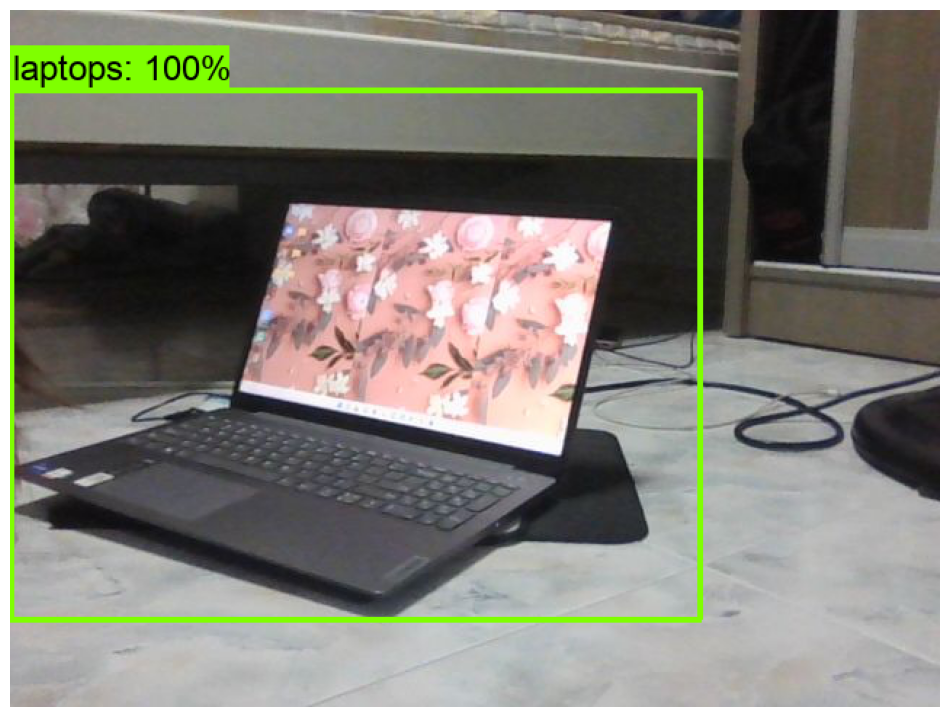

In [ ]:
from PIL import Image
try:
  filename = take_photo()
  print('Saved to {}'.format(filename))
  image_np = load_image_into_numpy_array(filename)

  # The input needs to be a tensor, convert it using `tf.convert_to_tensor`.
  input_tensor = tf.convert_to_tensor(image_np)
  # The model expects a batch of images, so add an axis with `tf.newaxis`.
  input_tensor = input_tensor[tf.newaxis, ...]
  print(input_tensor.shape)

  detections = detect_fn(input_tensor)

  # All outputs are batches tensors.
  # Convert to numpy arrays, and take index [0] to remove the batch dimension.
  # We're only interested in the first num_detections.
  num_detections = int(detections.pop('num_detections'))
  detections = {key: value[0, :num_detections].numpy()
                for key, value in detections.items()}
  detections['num_detections'] = num_detections

  # detection_classes should be ints.
  detections['detection_classes'] = detections['detection_classes'].astype(np.int64)

  image_np_with_detections = image_np.copy()

  viz_utils.visualize_boxes_and_labels_on_image_array(
        image_np_with_detections,
        detections['detection_boxes'],
        detections['detection_classes'],
        detections['detection_scores'],
        category_index,
        use_normalized_coordinates=True,
        max_boxes_to_draw=200,
        min_score_thresh=.8, # Adjust this value to set the minimum probability boxes to be classified as True
        agnostic_mode=False)
  %matplotlib inline
  plt.figure(figsize=IMAGE_SIZE, dpi=100)
  plt.axis("off")
  plt.imshow(image_np_with_detections)
  plt.show()

# Show the image which was just taken.
# display(Image(filename))
except Exception as err:
  # Errors will be thrown if the user does not have a webcam or if they do not
  # grant the page permission to access it.
  print(str(err))

<IPython.core.display.Javascript object>

Saved to photo.jpg
(1, 480, 640, 3)


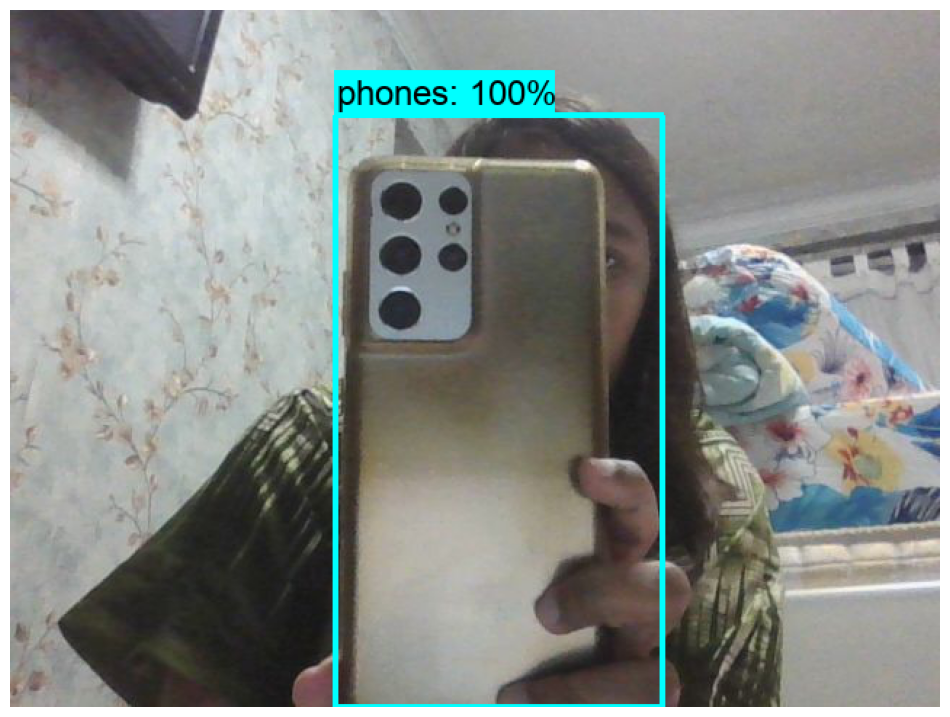

In [ ]:
from PIL import Image
try:
  filename = take_photo()
  print('Saved to {}'.format(filename))
  image_np = load_image_into_numpy_array(filename)

  # The input needs to be a tensor, convert it using `tf.convert_to_tensor`.
  input_tensor = tf.convert_to_tensor(image_np)
  # The model expects a batch of images, so add an axis with `tf.newaxis`.
  input_tensor = input_tensor[tf.newaxis, ...]
  print(input_tensor.shape)

  detections = detect_fn(input_tensor)

  # All outputs are batches tensors.
  # Convert to numpy arrays, and take index [0] to remove the batch dimension.
  # We're only interested in the first num_detections.
  num_detections = int(detections.pop('num_detections'))
  detections = {key: value[0, :num_detections].numpy()
                for key, value in detections.items()}
  detections['num_detections'] = num_detections

  # detection_classes should be ints.
  detections['detection_classes'] = detections['detection_classes'].astype(np.int64)

  image_np_with_detections = image_np.copy()

  viz_utils.visualize_boxes_and_labels_on_image_array(
        image_np_with_detections,
        detections['detection_boxes'],
        detections['detection_classes'],
        detections['detection_scores'],
        category_index,
        use_normalized_coordinates=True,
        max_boxes_to_draw=200,
        min_score_thresh=.8, # Adjust this value to set the minimum probability boxes to be classified as True
        agnostic_mode=False)
  %matplotlib inline
  plt.figure(figsize=IMAGE_SIZE, dpi=100)
  plt.axis("off")
  plt.imshow(image_np_with_detections)
  plt.show()

# Show the image which was just taken.
# display(Image(filename))
except Exception as err:
  # Errors will be thrown if the user does not have a webcam or if they do not
  # grant the page permission to access it.
  print(str(err))

<IPython.core.display.Javascript object>

Saved to photo.jpg
(1, 480, 640, 3)


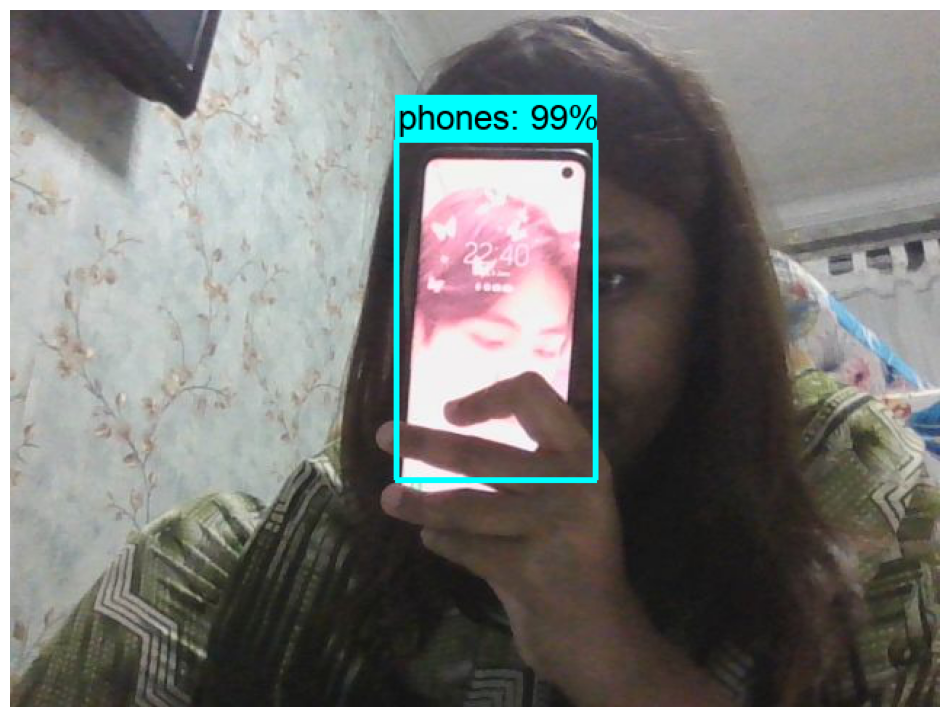

In [ ]:
from PIL import Image
try:
  filename = take_photo()
  print('Saved to {}'.format(filename))
  image_np = load_image_into_numpy_array(filename)

  # The input needs to be a tensor, convert it using `tf.convert_to_tensor`.
  input_tensor = tf.convert_to_tensor(image_np)
  # The model expects a batch of images, so add an axis with `tf.newaxis`.
  input_tensor = input_tensor[tf.newaxis, ...]
  print(input_tensor.shape)

  detections = detect_fn(input_tensor)

  # All outputs are batches tensors.
  # Convert to numpy arrays, and take index [0] to remove the batch dimension.
  # We're only interested in the first num_detections.
  num_detections = int(detections.pop('num_detections'))
  detections = {key: value[0, :num_detections].numpy()
                for key, value in detections.items()}
  detections['num_detections'] = num_detections

  # detection_classes should be ints.
  detections['detection_classes'] = detections['detection_classes'].astype(np.int64)

  image_np_with_detections = image_np.copy()

  viz_utils.visualize_boxes_and_labels_on_image_array(
        image_np_with_detections,
        detections['detection_boxes'],
        detections['detection_classes'],
        detections['detection_scores'],
        category_index,
        use_normalized_coordinates=True,
        max_boxes_to_draw=200,
        min_score_thresh=.8, # Adjust this value to set the minimum probability boxes to be classified as True
        agnostic_mode=False)
  %matplotlib inline
  plt.figure(figsize=IMAGE_SIZE, dpi=100)
  plt.axis("off")
  plt.imshow(image_np_with_detections)
  plt.show()

# Show the image which was just taken.
# display(Image(filename))
except Exception as err:
  # Errors will be thrown if the user does not have a webcam or if they do not
  # grant the page permission to access it.
  print(str(err))

<IPython.core.display.Javascript object>

Saved to photo.jpg
(1, 480, 640, 3)


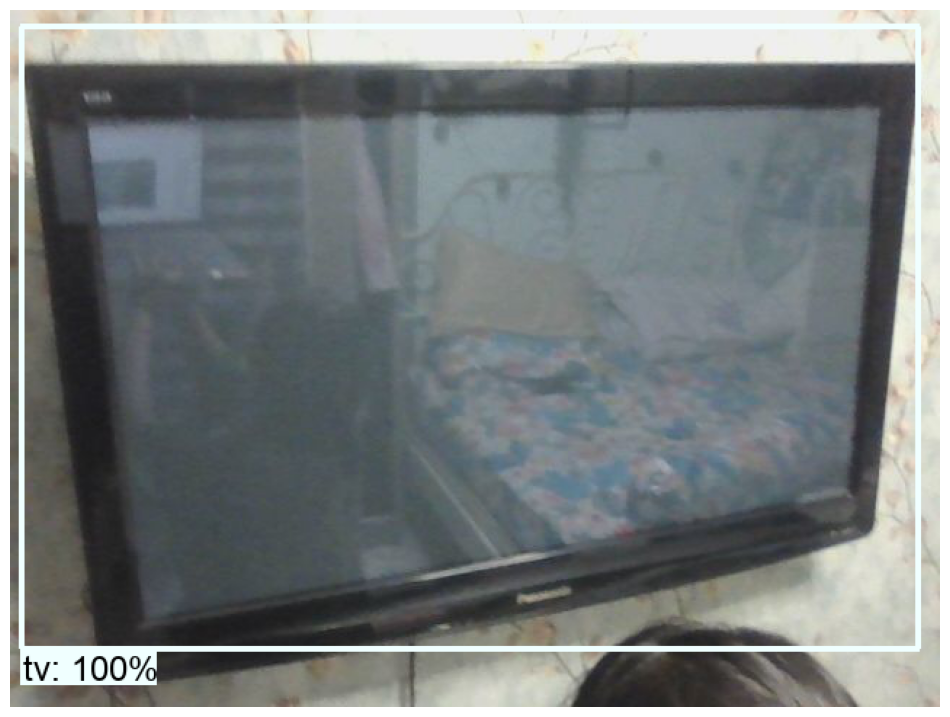

In [ ]:
from PIL import Image
try:
  filename = take_photo()
  print('Saved to {}'.format(filename))
  image_np = load_image_into_numpy_array(filename)

  # The input needs to be a tensor, convert it using `tf.convert_to_tensor`.
  input_tensor = tf.convert_to_tensor(image_np)
  # The model expects a batch of images, so add an axis with `tf.newaxis`.
  input_tensor = input_tensor[tf.newaxis, ...]
  print(input_tensor.shape)

  detections = detect_fn(input_tensor)

  # All outputs are batches tensors.
  # Convert to numpy arrays, and take index [0] to remove the batch dimension.
  # We're only interested in the first num_detections.
  num_detections = int(detections.pop('num_detections'))
  detections = {key: value[0, :num_detections].numpy()
                for key, value in detections.items()}
  detections['num_detections'] = num_detections

  # detection_classes should be ints.
  detections['detection_classes'] = detections['detection_classes'].astype(np.int64)

  image_np_with_detections = image_np.copy()

  viz_utils.visualize_boxes_and_labels_on_image_array(
        image_np_with_detections,
        detections['detection_boxes'],
        detections['detection_classes'],
        detections['detection_scores'],
        category_index,
        use_normalized_coordinates=True,
        max_boxes_to_draw=200,
        min_score_thresh=.8, # Adjust this value to set the minimum probability boxes to be classified as True
        agnostic_mode=False)
  %matplotlib inline
  plt.figure(figsize=IMAGE_SIZE, dpi=100)
  plt.axis("off")
  plt.imshow(image_np_with_detections)
  plt.show()

# Show the image which was just taken.
# display(Image(filename))
except Exception as err:
  # Errors will be thrown if the user does not have a webcam or if they do not
  # grant the page permission to access it.
  print(str(err))

<IPython.core.display.Javascript object>

Saved to photo.jpg
(1, 480, 640, 3)


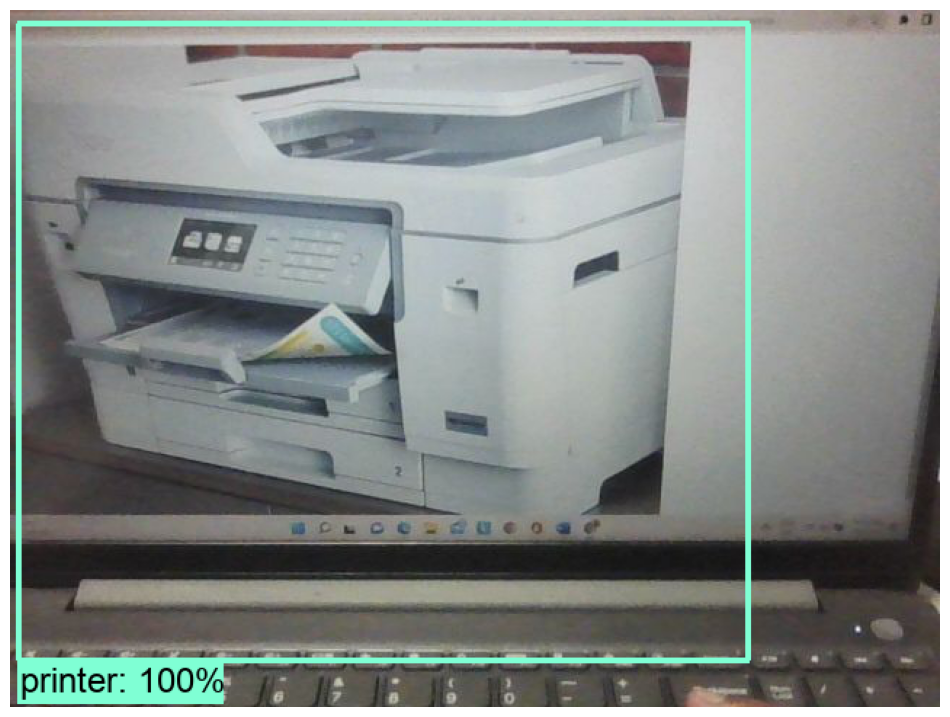

In [ ]:
from PIL import Image
try:
  filename = take_photo()
  print('Saved to {}'.format(filename))
  image_np = load_image_into_numpy_array(filename)

  # The input needs to be a tensor, convert it using `tf.convert_to_tensor`.
  input_tensor = tf.convert_to_tensor(image_np)
  # The model expects a batch of images, so add an axis with `tf.newaxis`.
  input_tensor = input_tensor[tf.newaxis, ...]
  print(input_tensor.shape)

  detections = detect_fn(input_tensor)

  # All outputs are batches tensors.
  # Convert to numpy arrays, and take index [0] to remove the batch dimension.
  # We're only interested in the first num_detections.
  num_detections = int(detections.pop('num_detections'))
  detections = {key: value[0, :num_detections].numpy()
                for key, value in detections.items()}
  detections['num_detections'] = num_detections

  # detection_classes should be ints.
  detections['detection_classes'] = detections['detection_classes'].astype(np.int64)

  image_np_with_detections = image_np.copy()

  viz_utils.visualize_boxes_and_labels_on_image_array(
        image_np_with_detections,
        detections['detection_boxes'],
        detections['detection_classes'],
        detections['detection_scores'],
        category_index,
        use_normalized_coordinates=True,
        max_boxes_to_draw=200,
        min_score_thresh=.8, # Adjust this value to set the minimum probability boxes to be classified as True
        agnostic_mode=False)
  %matplotlib inline
  plt.figure(figsize=IMAGE_SIZE, dpi=100)
  plt.axis("off")
  plt.imshow(image_np_with_detections)
  plt.show()

# Show the image which was just taken.
# display(Image(filename))
except Exception as err:
  # Errors will be thrown if the user does not have a webcam or if they do not
  # grant the page permission to access it.
  print(str(err))

*All in all, the model is able to detect the 4 different types of e-waste with an accuracy of above 90% (except for one exception). As shown in one of the outputs from the cells above, there was a picture with a tv and a monitor (these two items are rather similiar) in which the model detected the tv only with an accuracy of 87%. Images downloaded online and taken in real-time was able to detect e-waste with the correct label and accuracy of 99%-100% (except for that one picture of the tv and monitor together in one picture).*